<a href="https://colab.research.google.com/github/ImanLiao/COMP3029-ComputerVision/blob/main/COMP3029_Lab05.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction
This notebook is prepared by Dr. Iman Yi Liao. Main resources used https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html

The main objectives of the lab session are as follows.
1. To prepare Oil Palm Seeds Detection dataset 
2. To retrain a pretrained PyTorch Faster RCNN detector on Oil Palm Seeds dataset for seed detection

# Mount Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [1]:
%cd /content/drive/My Drive/AAR

/content/drive/My Drive/AAR


# Install Necessary Libraries

In [3]:
!pip install tensorboardX

     |████████████████████████████████| 317kB 5.8MB/s 


In [4]:
!pip install opencv-contrib-python==4.4.0.44

     |████████████████████████████████| 55.7MB 86kB/s 
  Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30


In [16]:
!pip install cython
!pip install pycocotools

# Annotate Oil Palm Dataset
There are various image annotation tools available, including:
- [MakeSense.AI](https://www.makesense.ai/)
- [LabelImg](https://github.com/tzutalin/labelImg)
- [VGG image annotator](https://gitlab.com/vgg/via)
- [LabelMe](http://labelme.csail.mit.edu/Release3.0/)
- [Scalable](https://scalabel.ai/)
- [RectLabel](https://rectlabel.com/)

I have tried with MakeSense.AI to label the bounding box for oil palm seeds. You can export your annotations in several forms including a csv file.

# Prepare Oil Palm Seeds Detection dataset
We will be using torch.utils.data.Dataset class to prepare the oil palm seeds detection dataset. The target sets will be different from that of the dataset for individual seed classification. 

## Dataset structure
- image: a PIL Image of size (H, W)
- target: a dict containing the following fields
  - boxes (FloatTensor[N, 4]): the coordinates of the N bounding boxes in [x0, y0, x1, y1] format, ranging from 0 to W and 0 to H 
  - labels (Int64Tensor[N]): the label for each bounding box. 0 represents always the background class.
  - image_id (Int64Tensor[1]): an image identifier. It should be unique between all the images in the dataset, and is used during evaluation
  - area (Tensor[N]): The area of the bounding box. This is used during evaluation with the COCO metric, to separate the metric scores between small, medium and large boxes.
  - iscrowd (UInt8Tensor[N]): instances with iscrowd=True will be ignored during evaluation.

In [8]:
import torch
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision.transforms import ToTensor, Lambda
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import os
import pandas as pd
from torchvision.io import read_image
import numpy as np

Playground-start

In [7]:
df = pd.read_csv("OilPalmBBoxLabels.csv")

In [8]:
df_img_list = df.imgName.unique()
print(df_img_list)

['GoodSeed0.jpg' 'GoodSeed1.jpg' 'GoodSeed2.jpg']


In [ ]:
result = df.isin([df_img_list[0]])
print(result)

In [10]:
rows = result['imgName'][result['imgName']==True].index
print(rows)

Int64Index([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype='int64')


Playground-end

In [9]:
class OilPalmSeedsDetectionDataset(Dataset):
    def __init__(self, df, base_path, transform=None, target_transform=None):
        '''
        Since our OilPalmBBoxLabels.csv file has a structure that one sample runs 
        through multiple rows, we need to restructure the dataframe df so that each sample 
        correponds to one index for __getitem__() function.
        '''
        self.df = df
        self.base_path = base_path
        self.transform = transform
        self.target_transform = target_transform
        # Obtain the unique list of image file names
        self.df_img_names = self.df.imgName.unique()

    def __len__(self):
        return len(self.df_img_names)

    def __getitem__(self, idx):
        img_name = self.df_img_names[idx]
        if 'GoodSeed' in img_name:
          img_path = os.path.join(self.base_path, 'GoodSeed/', img_name)
        elif 'BadSeed' in img_name:
          img_path = os.path.join(self.base_path, 'BadSeed/', img_name)
        img = read_image(img_path)

        # obtain all the bounding boxes and labels for the current image
        result = df.isin([img_name])
        rows = list(result['imgName'][result['imgName']==True].index)
        labels = torch.ones((len(rows),), dtype=torch.int64)  # as there are only two classes, i.e., the background and the oil palm seed
        boxes = []
        for row in rows:
          xmin = df['x1'][row]
          ymin = df['y1'][row]
          xmax = df['x2'][row]
          ymax = df['y2'][row]
          boxes.append([xmin, ymin, xmax, ymax])
        # convert everything into a torch.Tensor
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        image_id = torch.tensor([idx])
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((len(rows),), dtype=torch.int64)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['image_id'] = image_id
        target['area'] = area
        target['iscrowd'] = iscrowd

        # if any transformation is needed, e.g., to resize the image

        #if self.transforms is not None:
            #img, target = self.transforms(img, target)
        
        if self.target_transform:
            _, target = self.target_transform((img,target))
        if self.transform:
            img = self.transform(img)

        return img, target

Define transformation for images and targets, respectively.

In [10]:
# Note that the following transforms are not necessarily applicable to the raw images in our oil palm seeds dataset
# You will have to do something more appropriate and relevant
transform = transforms.Compose(
        [transforms.Resize([800, 800]),
         #transforms.RandomCrop(224),
         #transforms.RandomHorizontalFlip(),
         #transforms.ToTensor()
         ])

In [11]:
# Define our own target transform, particularly corresponding to the resize of the image
class MyTargetTransform(object):
    def __init__(self, target_size=800):
        # target_size is of (height,width) format for an image
        if isinstance(target_size, list):
          if len(target_size) == 2:
            self.target_size = target_size
          else:
            sys.exit('input target size must be either one integer or a list of two integers') 
        elif isinstance(target_size, int):
          self.target_size = [target_size, target_size]
        else:
          sys.exit('input target size must be either one integer or a list of two integers')

    def __call__(self, img_target_pair):
        img = img_target_pair[0]
        target = img_target_pair[1]
        img_h = img.shape[1]
        img_w = img.shape[2]
        # Resize the bounding boxes
        #boxes = torch.zeros(target['boxes'].shape)
        boxes = target['boxes']
        print(type(boxes))
        print(boxes.shape)
        print(boxes[:,1])
        print(self.target_size[0])
        # resize ymin
        boxes[:, 1] = boxes[:, 1] * (self.target_size[0]-1) / (img_h-1)
        # resize ymax
        boxes[:, 3] = boxes[:, 3] * (self.target_size[0]-1) / (img_h-1)
        # resize xmin
        boxes[:, 0] = boxes[:, 0] * (self.target_size[1]-1) / (img_w-1)
        # resize xmax
        boxes[:, 2] = boxes[:, 2] * (self.target_size[1]-1) / (img_w-1)
        # Recaculate the areas of bounding boxes
        target['area'] = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        target['boxes'] = boxes
        return img, target

In [12]:
target_transform = MyTargetTransform(target_size=800)

Create the training and testing dataset.

In [13]:
# load the training csv file in terms of annotations to dataframe and randomly split it to training and validation sets respectively
df = pd.read_csv("OilPalmBBoxLabels.csv")
base_path = '/content/drive/My Drive/AAR/seed/'
total_dataset = OilPalmSeedsDetectionDataset(df, base_path=base_path, transform=transform, target_transform=target_transform)

# Create training and testing dataset with OilPalmSeedsDetectionDataset
len_train = int(0.8*len(total_dataset))
train_dataset, test_dataset = torch.utils.data.random_split(total_dataset, [len_train, len(total_dataset)-len_train])

print('training set', len(train_dataset))
print('test set', len(test_dataset))

# Load the dataset with DataLoader
train_dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=4)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=True, num_workers=4)


training set 2
test set 1


Inspect the dataset that was just loaded

In [27]:
for sample in train_dataloader:
  img, target = sample
  print(img.size())
  print(len(target))
  #plt.imshow(img[0].permute(1,2,0)) # change (C,H,W) to (H,W,C)
  #plt.show()
  print(target['boxes'][0])
  break

<class 'torch.Tensor'>
torch.Size([10, 4])
tensor([2291., 2340., 2299., 2280., 2288., 2273., 2273., 2288., 2243., 2224.])
800
<class 'torch.Tensor'>
torch.Size([10, 4])
tensor([2269., 2284., 2254., 2254., 2261., 2228., 2205., 2243., 2224., 2190.])
800
torch.Size([2, 3, 800, 800])
5
tensor([[ 44.8351, 501.9218,  53.0135,  63.0962],
        [109.6781, 512.6570,  38.2632,  59.8100],
        [161.5233, 503.6745,  49.6545,  64.6298],
        [228.1188, 499.5119,  40.4538,  75.3650],
        [292.5237, 501.2646,  46.4416,  76.2413],
        [371.6789, 497.9783,  46.4416,  63.9726],
        [440.4650, 497.9783,  38.7013,  59.8100],
        [495.6692, 501.2646,  42.0603,  67.0398],
        [578.6215, 491.4058,  43.0826,  75.3650],
        [662.7421, 487.2432,  44.2510,  76.8985]])


# PyTorch Faster RCNN
Faster RCNN implementation in PyTorch is based on ResNet50, unlike most of the other implementations which are based on VGG16. It is pretrained on COCO dataset.

Use GPU whenever necessary for training your model.

In [15]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('Using {} device'.format(device))

Using cuda:0 device


## Input format for Faster RCNN
The image will be in the format of [channels x height x width]. But for trained Faster RCNN, the input has to be 4 dimensional, [batch_size x channels x height x width]. The batch size here is the number of images per forward pass. If you pass only one image, it is going to be 1.

The Faster RCNN network resizes all the images to 800×800 pixels by default. 

## Output format for Faster RCNN
The Faster RCNN detector outputs a list of dictionary. And this dictionary has three keys. They are scores, boxes, and labels. The scores contain all the confidence values of each detection. The boxes contain all the bounding box coordinates in [x_min, y_min, x_max, y_max] format. And the labels contain all the label indices.

The list is of a single dimensiona. To access all the values in the dictionary keys, we will have to use the following format.

outputs[0]['boxes'] to access all the bounding boxes.
outputs[0]['labels'] for accessing all the labels.
outputs[0]['scores'] to access all the detection scores.

## Fine-tuning from a pretrained model

In [16]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

In [17]:
# load a model pre-trained pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

# replace the classifier with a new one, that has
# num_classes which is user-defined
num_classes = 2  # 1 class (oil palm seed) + background
# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

## Modifying the model to add a different backbone

In [18]:
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator

# load a pre-trained model for classification and return
# only the features
backbone = torchvision.models.mobilenet_v2(pretrained=True).features
# FasterRCNN needs to know the number of
# output channels in a backbone. For mobilenet_v2, it's 1280
# so we need to add it here
backbone.out_channels = 1280

# let's make the RPN generate 5 x 3 anchors per spatial
# location, with 5 different sizes and 3 different aspect
# ratios. We have a Tuple[Tuple[int]] because each feature
# map could potentially have different sizes and
# aspect ratios
anchor_generator = AnchorGenerator(sizes=((32, 64, 128, 256, 512),),
                                   aspect_ratios=((0.5, 1.0, 2.0),))

# let's define the feature maps that we will
# use to perform the region of interest cropping, as well as
# the size of the crop after rescaling.
# if your backbone returns a Tensor, featmap_names is expected to
# be [0]. More generally, the backbone should return an
# OrderedDict[Tensor], and in featmap_names you can choose which
# feature maps to use.
roi_pooler = torchvision.ops.MultiScaleRoIAlign(featmap_names=[0],
                                                output_size=7,
                                                sampling_ratio=2)

# put the pieces together inside a FasterRCNN model
model = FasterRCNN(backbone,
                   num_classes=2,
                   rpn_anchor_generator=anchor_generator,
                   box_roi_pool=roi_pooler)

## Training and evaluation

In [19]:
from detection.engine import train_one_epoch, evaluate
from detection import utils

In [23]:
    # move model to the right device
    model.to(device)

    # construct an optimizer
    params = [p for p in model.parameters() if p.requires_grad]
    optimizer = torch.optim.SGD(params, lr=0.005,
                                momentum=0.9, weight_decay=0.0005)
    # and a learning rate scheduler
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                                   step_size=3,
                                                   gamma=0.1)

    # let's train it for 10 epochs
    num_epochs = 10

    for epoch in range(num_epochs):
        # train for one epoch, printing every 10 iterations
        train_one_epoch(model, optimizer, train_dataloader, device, epoch, print_freq=10)
        # update the learning rate
        lr_scheduler.step()
        # evaluate on the test dataset
        evaluate(model, test_dataloader, device=device)


<class 'torch.Tensor'>
torch.Size([10, 4])
tensor([2269., 2284., 2254., 2254., 2261., 2228., 2205., 2243., 2224., 2190.])
800
<class 'torch.Tensor'>
torch.Size([10, 4])
tensor([2291., 2340., 2299., 2280., 2288., 2273., 2273., 2288., 2243., 2224.])
800


AttributeError: ignored

## Write predict() function
To output the predictions when we give the model an image as the input.

In [14]:
def predict(image, model, device, detection_threshold):
    # transform the image to tensor
    image = transform(image).to(device)
    image = image.unsqueeze(0) # add a batch dimension
    outputs = model(image) # get the predictions on the image
    # print the results individually
    # print(f"BOXES: {outputs[0]['boxes']}")
    # print(f"LABELS: {outputs[0]['labels']}")
    # print(f"SCORES: {outputs[0]['scores']}")
    # get all the predicited class names
    pred_classes = [coco_names[i] for i in outputs[0]['labels'].cpu().numpy()]
    # get score for all the predicted objects
    pred_scores = outputs[0]['scores'].detach().cpu().numpy()
    # get all the predicted bounding boxes
    pred_bboxes = outputs[0]['boxes'].detach().cpu().numpy()
    # get boxes above the threshold score
    boxes = pred_bboxes[pred_scores >= detection_threshold].astype(np.int32)
    return boxes, pred_classes, outputs[0]['labels']

## Write a bounding box drawing function

In [15]:
def draw_boxes(boxes, classes, labels, image):
    # read the image with OpenCV
    image = cv2.cvtColor(np.asarray(image), cv2.COLOR_BGR2RGB)
    for i, box in enumerate(boxes):
        color = COLORS[labels[i]]
        cv2.rectangle(
            image,
            (int(box[0]), int(box[1])),
            (int(box[2]), int(box[3])),
            color, 2
        )
        cv2.putText(image, classes[i], (int(box[0]), int(box[1]-5)),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2, 
                    lineType=cv2.LINE_AA)
    return image

## Detecting Objects in Images using PyTorch Faster RCNN

In [16]:
import torchvision
import numpy
import torch
import argparse
import cv2
from PIL import Image

Initializing the Faster RCNN ResNet50 Network

In [17]:
# download or load the model from disk
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, 
                                                    min_size=800)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


Detecting object

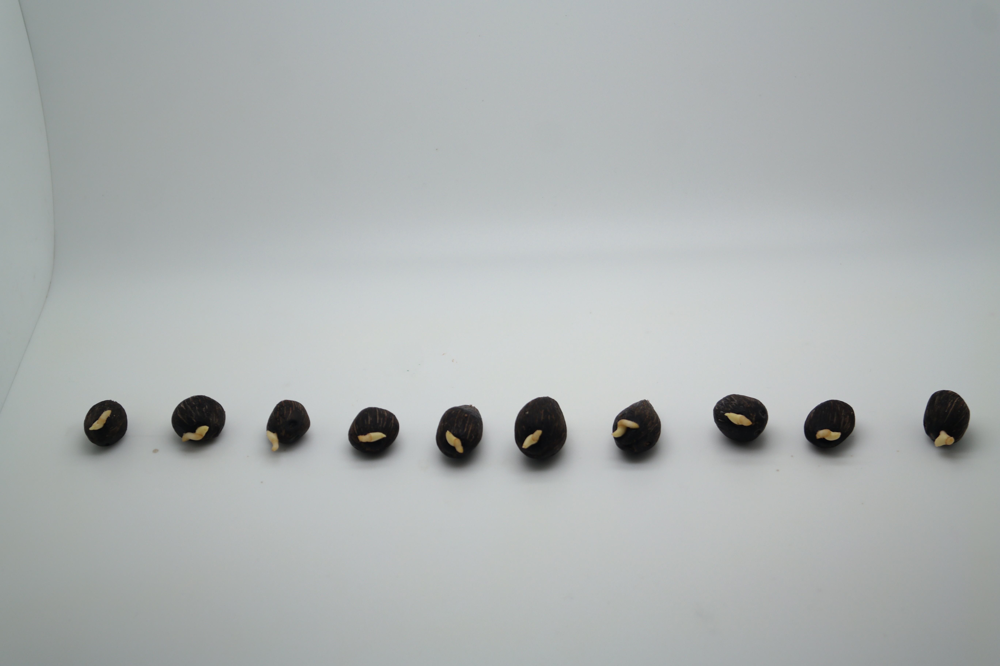

False

In [22]:
from google.colab.patches import cv2_imshow

subfolder = 'GoodSeed/' if testdf.iloc[0,1] ==1 else 'BadSeed/' 
fullname = base_path + subfolder + testdf.iloc[0,0]
image = Image.open(fullname)
model.eval().to(device)
boxes, classes, labels = predict(image, model, device, 0.8)
image = draw_boxes(boxes, classes, labels, image)
cv2_imshow(image)
save_name = f"{fullname.split('/')[-1].split('.')[0]}_800"
cv2.imwrite(f"outputs/{save_name}.jpg", image)
#cv2.waitKey(0)